Import Relevant Libraries

In [1]:
# Data Manipulation
import numpy as np
import pandas as pd

# Data Visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from statsmodels.graphics.gofplots import qqplot

# Preprocessing
from sklearn.utils import shuffle
from sklearn.preprocessing import RobustScaler, StandardScaler, MinMaxScaler
from sklearn.pipeline import make_pipeline
from sklearn.compose import ColumnTransformer, make_column_transformer


# Clustering
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from kneed import KneeLocator


# Modelling
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report,accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
import joblib


np.random.seed(42)
%autosave 60

Autosaving every 60 seconds


# Import Data 

In [3]:
df = shuffle(pd.read_csv("../data/SpotifyFeatures.csv"), random_state=42)
df.head()

,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
788,Country,A Thousand Horses,My Time's Comin',16zol4GvHyTER5irYODUk0,45,0.00192,0.327,194107,0.8350,0.000150,C,0.1670,-4.952,Major,0.0609,171.795,4/4,0.3850
207109,Soundtrack,Mark Mothersbaugh,House Tour,6ac5gUfGTckpdGQCyWsdh2,25,0.93200,0.253,102920,0.0798,0.568000,C,0.0906,-18.512,Major,0.0439,110.931,4/4,0.0487
138644,Reggae,Unified Highway,We Can't Fall (Remix) [feat. J. Patz],09Yz6koF1Y15n1012t1UX6,19,0.03310,0.821,225437,0.7370,0.013400,E,0.1320,-6.295,Minor,0.2120,137.968,4/4,0.7870
37164,Electronic,Stooki Sound,Endz - Original Mix,3dzEZARDL4ZwICMKVta7Xn,29,0.00428,0.745,225400,0.7720,0.114000,E,0.0722,-3.949,Major,0.0904,133.113,4/4,0.1700
174351,Comedy,Bill Hicks,I Love My Job (Live),39Z1G5384UgGa5vmW6WyxC,17,0.96500,0.502,287973,0.8040,0.000096,G,0.9020,-9.935,Major,0.8070,104.576,3/4,0.1850


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 232725 entries, 788 to 121958
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   genre             232725 non-null  object 
 1   artist_name       232725 non-null  object 
 2   track_name        232724 non-null  object 
 3   track_id          232725 non-null  object 
 4   popularity        232725 non-null  int64  
 5   acousticness      232725 non-null  float64
 6   danceability      232725 non-null  float64
 7   duration_ms       232725 non-null  int64  
 8   energy            232725 non-null  float64
 9   instrumentalness  232725 non-null  float64
 10  key               232725 non-null  object 
 11  liveness          232725 non-null  float64
 12  loudness          232725 non-null  float64
 13  mode              232725 non-null  object 
 14  speechiness       232725 non-null  float64
 15  tempo             232725 non-null  float64
 16  time_signature    23272

In [5]:
#EDA 

df.isna().sum()


genre               0
artist_name         0
track_name          1
track_id            0
popularity          0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
speechiness         0
tempo               0
time_signature      0
valence             0
dtype: int64

In [6]:
# Duplicates

df.duplicated().sum()


0

In [7]:
# Drop cateforical features
df_num = df.select_dtypes(exclude = ['object'])
df_num.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
788,45,0.00192,0.327,194107,0.8350,0.000150,0.1670,-4.952,0.0609,171.795,0.3850
207109,25,0.93200,0.253,102920,0.0798,0.568000,0.0906,-18.512,0.0439,110.931,0.0487
138644,19,0.03310,0.821,225437,0.7370,0.013400,0.1320,-6.295,0.2120,137.968,0.7870
37164,29,0.00428,0.745,225400,0.7720,0.114000,0.0722,-3.949,0.0904,133.113,0.1700
174351,17,0.96500,0.502,287973,0.8040,0.000096,0.9020,-9.935,0.8070,104.576,0.1850


In [8]:
# Distributions..

# Checking Skewness

skewness = df_num.skew()

# Create a new DataFrame with the skewness values
skewness_df = pd.DataFrame(skewness)

# Rename the column '0' to 'skewness'
skewness_df = skewness_df.rename(columns={0: 'skewness'})

skewness_df.sort_values(by='skewness', ascending=False)

,skewness
duration_ms,9.893376
speechiness,3.311269
liveness,2.074093
instrumentalness,1.819766
acousticness,0.534242
tempo,0.403350
valence,0.144131
popularity,-0.336390
danceability,-0.378278
energy,-0.400223


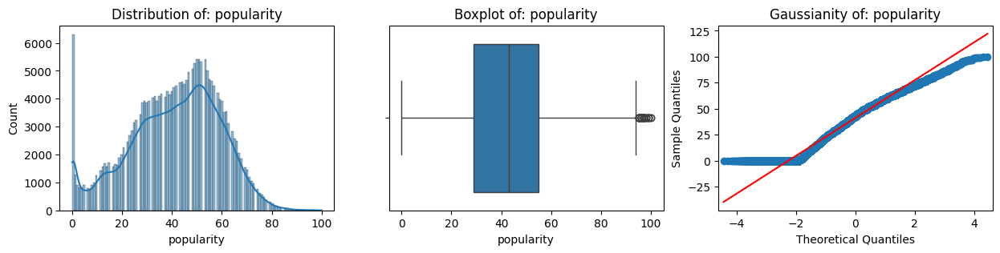

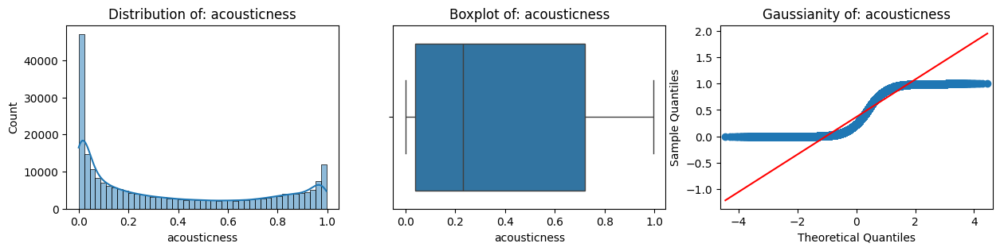

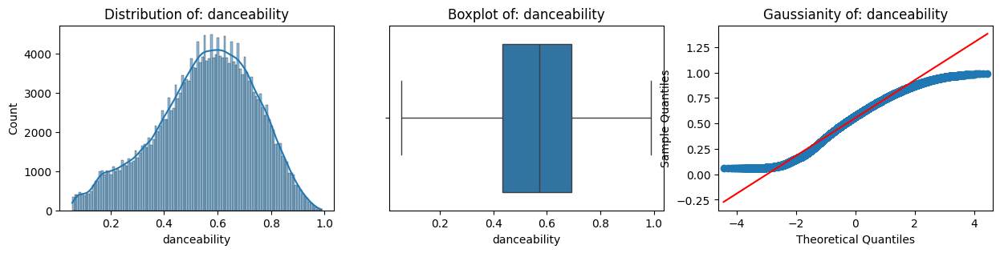

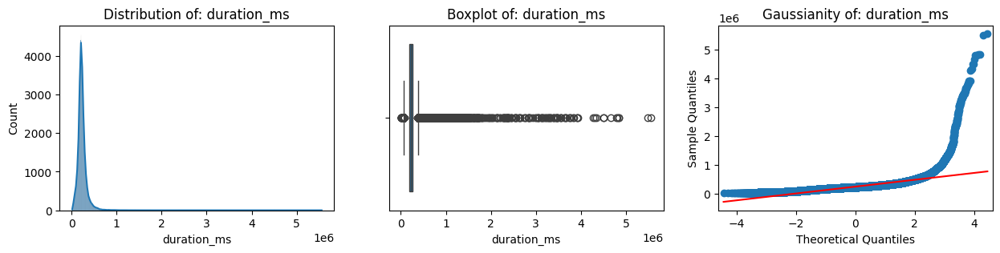

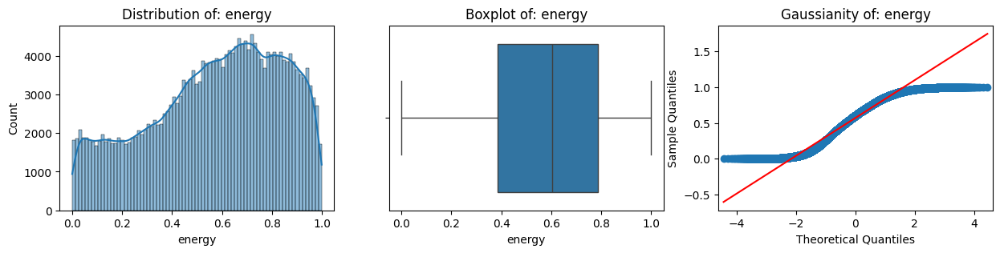

...

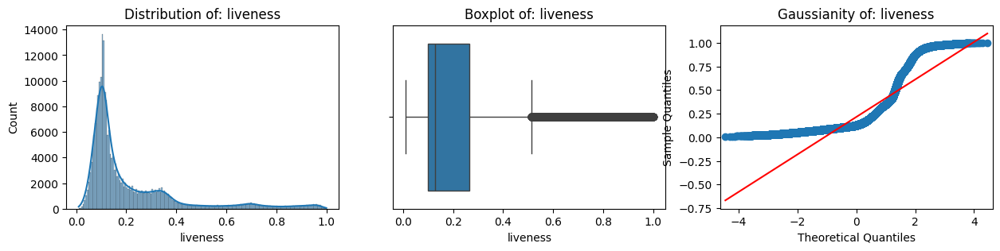

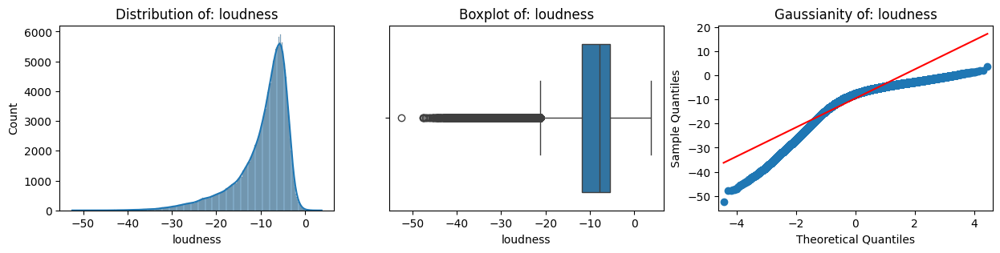

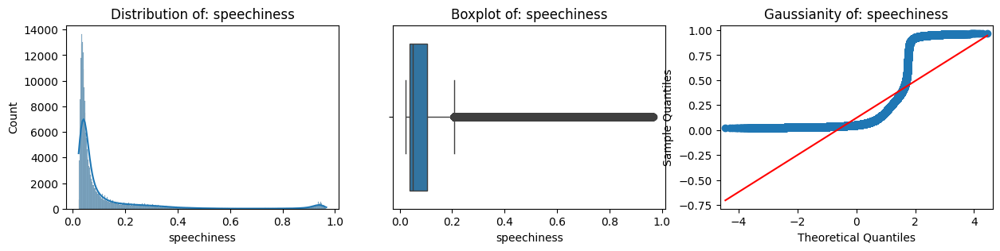

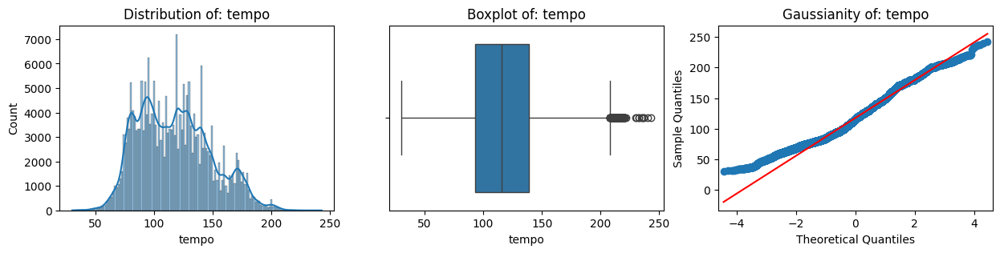

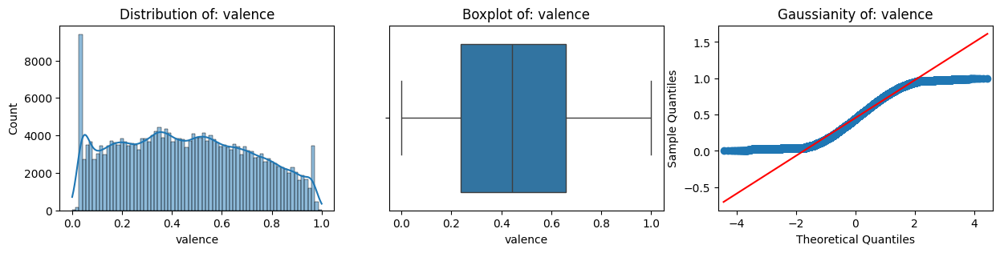

In [9]:
#. Visualizations..


for numerical_feature in df_num.columns:

    # Creating three subplots per numerical_feature
    fig, ax =plt.subplots(1,3,figsize=(15,3))

    # Histogram to get an overview of the distribution of each numerical_feature
    ax[0].set_title(f"Distribution of: {numerical_feature}")
    sns.histplot(data = df_num, x = numerical_feature, kde=True, ax = ax[0])

    # Boxplot to detect outliers
    ax[1].set_title(f"Boxplot of: {numerical_feature}")
    sns.boxplot(data = df_num, x = numerical_feature, ax=ax[1])

    # Analyzing whether a feature is normally distributed or not
    ax[2].set_title(f"Gaussianity of: {numerical_feature}")
    qqplot(df_num[numerical_feature],line='s',ax=ax[2]);


In [10]:
# df_num.columns
# Suggestion for scaling

features_robust = ["duration_ms", "instrumentalness", "liveness", "loudness", "speechiness", "tempo"]

features_standard = ["danceability"]

features_minmax = ["popularity", "acousticness", "energy", "valence"]

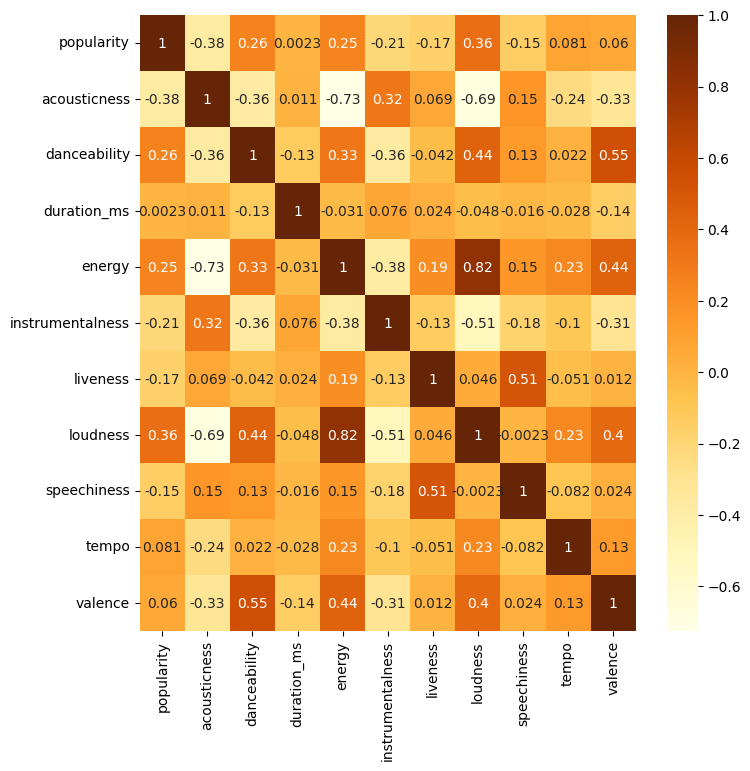

In [11]:
# Correlation Matrix

plt.figure(figsize=(8,8))

sns.heatmap(df_num.corr(),
            annot = True,
            annot_kws = {"fontsize":10},
            cmap='YlOrBr');

In [12]:
# Clustering

# Fitting a baseline model

baseline = KMeans(n_clusters = 8, n_init = "auto", random_state=42)
baseline.fit(df_num)

labels_baseline = baseline.labels_
labels_baseline

array([7, 3, 0, ..., 7, 0, 7])

In [13]:
# Plotting 3 features

fig = px.scatter_3d(df_num,
                    x = 'loudness',
                    y = 'energy',
                    z = 'acousticness',
                    color = labels_baseline, width=500, height=500)
fig.show()

In [14]:

# Plotting 3 features

fig = px.scatter_3d(df_num,
                    x = 'danceability',
                    y = 'energy',
                    z = 'speechiness',
                    color = labels_baseline, width=500, height=500)

fig.show()

In [15]:
# Preprocessing..

# Column Transformer and Pipeline with the 3 Scalers

scalers = ColumnTransformer(
    transformers=[
        ("robust_scaler", RobustScaler(), features_robust),
        ("standard_scaler", StandardScaler(), features_standard),
        ("minmax_scaler", MinMaxScaler(), features_minmax)
    ],
    remainder='passthrough'
)


num_transformer = make_pipeline(scalers)
num_transformer

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('robust_scaler',
                                                  RobustScaler(),
                                                  ['duration_ms',
                                                   'instrumentalness',
                                                   'liveness', 'loudness',
                                                   'speechiness', 'tempo']),
                                                 ('standard_scaler',
                                                  StandardScaler(),
                                                  ['danceability']),
                                                 ('minmax_scaler',
                                                  MinMaxScaler(),
                                                  ['popularity', 'acousticness',
                                                   'energy', 'valence'])]))])

In [16]:
# Let's plot the result

df_num_scaled = pd.DataFrame(num_transformer.fit_transform(df_num), columns=df_num.columns)
df_num_scaled.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
0,-0.317449,0.002953,0.234094,0.448166,0.158126,1.215251,-1.224972,0.45,0.001928,0.835832,0.3850
1,-1.417267,15.864684,-0.224490,-1.714514,-0.090776,-0.105152,-1.623663,0.25,0.935743,0.079861,0.0487
2,0.060426,0.373064,0.024010,0.233971,2.370425,0.481397,1.436553,0.19,0.033233,0.737732,0.7870
3,0.059980,3.183120,-0.334934,0.608134,0.590044,0.376071,1.027088,0.29,0.004297,0.772768,0.1700
4,0.814681,0.001433,4.645858,-0.346571,11.081991,-0.243020,-0.282124,0.17,0.968876,0.804801,0.1850


In [17]:
df_num.head()


,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
788,45,0.00192,0.327,194107,0.8350,0.000150,0.1670,-4.952,0.0609,171.795,0.3850
207109,25,0.93200,0.253,102920,0.0798,0.568000,0.0906,-18.512,0.0439,110.931,0.0487
138644,19,0.03310,0.821,225437,0.7370,0.013400,0.1320,-6.295,0.2120,137.968,0.7870
37164,29,0.00428,0.745,225400,0.7720,0.114000,0.0722,-3.949,0.0904,133.113,0.1700
174351,17,0.96500,0.502,287973,0.8040,0.000096,0.9020,-9.935,0.8070,104.576,0.1850


In [18]:
# Fitting a KMeand model

kmeans_scaled = KMeans(n_clusters = 8, n_init = "auto", random_state=42)
kmeans_scaled.fit(df_num_scaled)

KMeans(n_init='auto', random_state=42)

In [19]:
labels_scaled = kmeans_scaled.labels_
labels_scaled

array([2, 5, 0, ..., 2, 6, 2])

In [20]:
# Plotting 3 features with the scaled data

fig = px.scatter_3d(df_num_scaled,
                    x = 'danceability',
                    y = 'energy',
                    z = 'speechiness',
                    color = labels_scaled, width=500, height=500)
fig.show()

In [21]:
# Fitting PCA

pca = PCA()
pca.fit(df_num_scaled)

PCA()

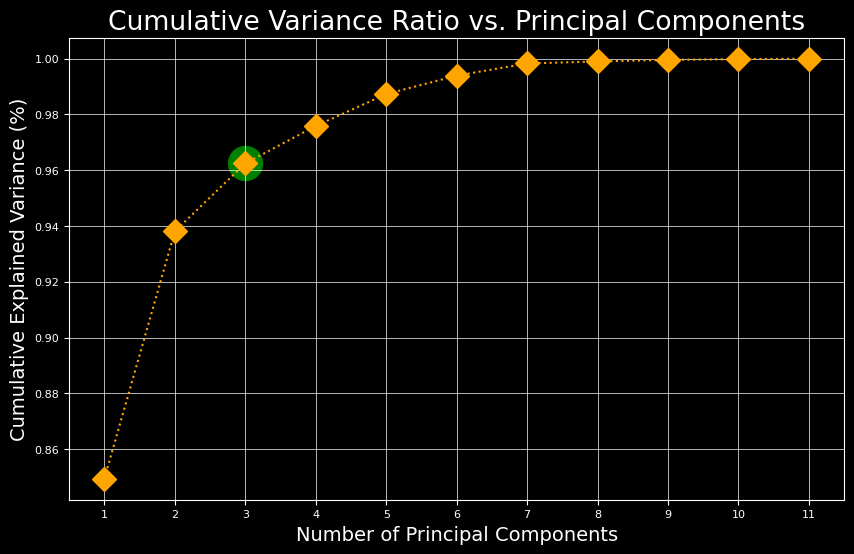

In [22]:
# Using the elbow method to find the right number of PCAs

with plt.style.context("dark_background"):
    # Set larger font and label sizes
    plt.rcParams['font.size'] = 16
    plt.rcParams['axes.labelsize'] = 14
    plt.rcParams['xtick.labelsize'] = 8
    plt.rcParams['ytick.labelsize'] = 8

    # Create a new figure with custom colors and styles
    plt.figure(figsize=(10, 6))
    ax = plt.gca()

    explained_variance_ratio_cumulated = np.cumsum(pca.explained_variance_ratio_)
    x_axis_ticks = np.arange(1, explained_variance_ratio_cumulated.shape[0] + 1)

    # Find the position where explained_variance_ratio_cumulated exceeds 0.8
    nr_PC = np.argmax(explained_variance_ratio_cumulated > 0.95) + 1

    # Plot the cumulative explained variance with custom styles
    ax.plot(x_axis_ticks, explained_variance_ratio_cumulated, label="Cumulative Variance Ratio", color="orange", linestyle=":", marker="D", markersize=12)

    # Customizing the plot
    ax.set_xlabel('Number of Principal Components')
    ax.set_ylabel('Cumulative Explained Variance (%)')
    ax.set_title('Cumulative Variance Ratio vs. Principal Components')
    ax.set_xticks(x_axis_ticks)

    # Highlight the point where explained_variance_ratio_cumulated exceeds 0.8 with a larger green dot
    ax.scatter(nr_PC, explained_variance_ratio_cumulated[nr_PC - 1], c='green', s=600)
    ax.grid(axis="x", linewidth=0.5)
    ax.grid(axis="y", linewidth=0.5)

plt.show()

In [23]:
# Fitting the model with the calculated PCAs

threhsold_pca = nr_PC

pca = PCA(n_components=threhsold_pca, whiten=True)
pca.fit(df_num_scaled)

df_pca = pd.DataFrame(pca.transform(df_num_scaled))
df_pca

,0,1,2
0,-0.478658,-0.464909,-0.198154
1,1.400226,-0.171967,-1.092382
2,-0.462381,0.331910,-0.222318
3,-0.119134,-0.267029,-0.216810
4,-0.565017,3.813702,0.613637
...,...,...,...
232720,-0.487743,-0.174645,-0.107626
232721,1.283590,0.152184,-1.217889
232722,-0.484839,-0.478693,-0.277069
232723,-0.228366,-0.628722,0.189944


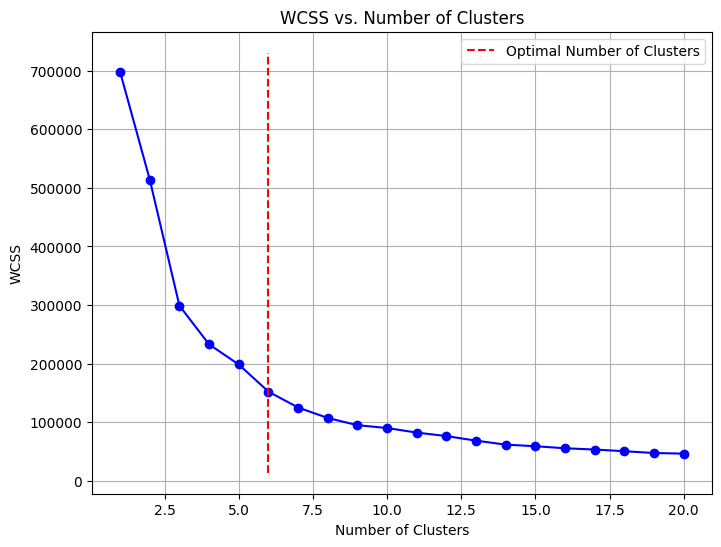

Optimal number of clusters: 6


In [24]:
# Finding the right number of clusters

wcss = []

max_clusters = 21

for i in range(1, max_clusters):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42, n_init="auto")
    kmeans.fit(df_pca)
    wcss.append(kmeans.inertia_)

# Plot the WCSS curve
plt.figure(figsize=(8, 6))
plt.plot(range(1, max_clusters), wcss, marker='o', linestyle='-', color='b')
plt.title('WCSS vs. Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)

# Use KneeLocator to find the optimal number of clusters
knee_locator = KneeLocator(range(1, max_clusters), wcss, curve='convex', direction='decreasing')

# Mark the "elbow" point on the plot
plt.vlines(knee_locator.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='--', colors='r', label='Optimal Number of Clusters')
plt.legend()

# Show the plot
plt.show()

# Print the optimal number of clusters
print("Optimal number of clusters:", knee_locator.elbow)

In [25]:
# Plotting 3 features with the scaled data and reduced dimensions

nr_clusters = knee_locator.elbow

print('Working with ' + str(nr_clusters) + ' clusters and ' + str(nr_PC) + " PCs", flush=True)
print("-"*33)

kmeans = KMeans(n_clusters = nr_clusters, max_iter = 300, n_init = "auto")

kmeans.fit(df_pca)

labels = kmeans.labels_

fig_scaled = px.scatter_3d(df_pca,
                           x = 0,
                           y = 1,
                           z = 2,
                           color=labels,
                           width=500,
                           height=500)
fig_scaled.show()

Working with 6 clusters and 3 PCs
---------------------------------


In [26]:
# Plotting the whole dataframe with labels

df_labelled = pd.concat([df, pd.Series(labels)],axis=1).rename(columns={0: "cluster"}).dropna()
df_labelled.cluster = df_labelled.cluster.astype(int)
df_labelled

,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,cluster
788,Country,A Thousand Horses,My Time's Comin',16zol4GvHyTER5irYODUk0,45,0.001920,0.327,194107,0.8350,0.000150,C,0.1670,-4.952,Major,0.0609,171.795,4/4,0.3850,0
207109,Soundtrack,Mark Mothersbaugh,House Tour,6ac5gUfGTckpdGQCyWsdh2,25,0.932000,0.253,102920,0.0798,0.568000,C,0.0906,-18.512,Major,0.0439,110.931,4/4,0.0487,0
138644,Reggae,Unified Highway,We Can't Fall (Remix) [feat. J. Patz],09Yz6koF1Y15n1012t1UX6,19,0.033100,0.821,225437,0.7370,0.013400,E,0.1320,-6.295,Minor,0.2120,137.968,4/4,0.7870,0
37164,Electronic,Stooki Sound,Endz - Original Mix,3dzEZARDL4ZwICMKVta7Xn,29,0.004280,0.745,225400,0.7720,0.114000,E,0.0722,-3.949,Major,0.0904,133.113,4/4,0.1700,1
174351,Comedy,Bill Hicks,I Love My Job (Live),39Z1G5384UgGa5vmW6WyxC,17,0.965000,0.502,287973,0.8040,0.000096,G,0.9020,-9.935,Major,0.8070,104.576,3/4,0.1850,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119879,Rap,Gunna,Phase,1bbdOPM7WXBc2Dw3YiN6KE,52,0.461000,0.810,231338,0.3830,0.000000,G#,0.1420,-11.252,Major,0.1110,124.981,4/4,0.2820,0
103694,Children’s Music,J Dilla,Time: The Donut of the Heart,7oeWitA7Lu8O76NrmhfgZ8,45,0.068500,0.419,98720,0.7130,0.541000,F,0.2910,-8.867,Minor,0.0976,186.785,4/4,0.5550,0
131932,Reggae,Sublime With Rome,Spun,2glQQps2SfltkzBZ3JW26X,36,0.008660,0.671,207067,0.8260,0.000214,G,0.0751,-5.279,Major,0.0619,95.006,4/4,0.6710,0
146867,Jazz,Skinshape,Summer,7MNTf5d8T971NWUcqhgPlH,51,0.000908,0.706,268858,0.7200,0.076500,C,0.0487,-7.581,Major,0.0246,91.985,4/4,0.8460,0


In [27]:
# Save df for playlist prediction in App

df_labelled[["genre","artist_name","track_name", "cluster"]].to_csv("../data/labelled_dataset.csv", index=False)

In [28]:
# PLot the radar for all clusters

df_num_labelled = pd.concat([df_num_scaled, pd.Series(labels)],axis=1).rename(columns={0: "cluster"}).dropna()


colors = px.colors.qualitative.Safe

fig = go.Figure()

angles = list(df_num_labelled.columns[:-1])
angles.append(angles[0])


for i in range(nr_clusters):
    subset = df_num_labelled[df_num_labelled['cluster'] == i]
    data = [np.mean(subset[col]) for col in subset.columns[:-1]]
    data.append(data[0])

    fig.add_trace(go.Scatterpolar(
        r=data,
        theta=angles,
        fill='toself',
        name="Cluster " + str(i),
        text=['Feature ' + str(j) + ': ' + str(data[j]) for j in range(len(data))],
        hoverinfo='text',
        line=dict(color=colors[i % len(colors)])))


fig.update_layout(
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, 1]
        )
    ),
    showlegend=True
)

fig.show()

In [29]:
# PLot the radar for each clusters

colors = px.colors.qualitative.Safe

figures = []

angles = list(df_num_labelled.columns[:-1])
angles.append(angles[0])

for i in range(nr_clusters):
    subset = df_num_labelled[df_num_labelled['cluster'] == i]
    data = [np.mean(subset[col]) for col in subset.columns[:-1]]
    data.append(data[0])

    fig = go.Figure(go.Scatterpolar(
        r=data,
        theta=angles,
        fill='toself',
        text=['Feature ' + str(j) + ': ' + str(data[j]) for j in range(len(data))],
        hoverinfo='text',
        line=dict(color=colors[i % len(colors)])
    ))

    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 1]
            )
        ),
        title=f'Cluster {i+1}'
    )

    figures.append(fig)
    
# Display the figures
for fig in figures:
    fig.show()
    

In [30]:
daily_mixes = {}

for cluster in np.unique(labels):
    daily_mixes[cluster] = df_labelled[df_labelled.cluster == cluster]



for key,value in daily_mixes.items():
    print("-"*55)
    print(f"Here are some songs for the playlist of the Cluster {key}")
    print("-"*55)
    display(value.sample(20))

-------------------------------------------------------
Here are some songs for the playlist of the Cluster 0
-------------------------------------------------------


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,cluster
59835,R&B,Little Mix,Motivate,1IKzLByg2KGGUlvCDQKVJv,63,0.17900,0.6520,201720,0.79000,0.000002,C#,0.0595,-5.122,Major,0.0675,145.992,4/4,0.6160,0
209965,World,"Phillips, Craig & Dean",You Are My King (Amazing Love),7iVZYV4h12TVHQpxJxCLmN,38,0.39100,0.4860,316464,0.61100,0.000771,F#,0.1420,-7.847,Major,0.0327,136.263,4/4,0.2650,0
207228,World,Hillsong Worship,Touch Of Heaven - Live,0pfm3xmeB1xNdTcKap5Jum,58,0.13300,0.4000,427547,0.43800,0.000000,A,0.1040,-7.934,Major,0.0295,134.893,4/4,0.2210,0
146201,Jazz,B-Side,floating high,1FFcVh03GQnkKvBoXBeT9I,55,0.47200,0.6180,147044,0.16500,0.907000,F,0.1300,-8.438,Minor,0.1330,162.405,4/4,0.2750,0
175017,Comedy,The Toilet Bowl Cleaners,The Fart Song!,7fQo2DCVyvPvI2IZq95K89,15,0.28300,0.5790,122733,0.63300,0.000000,C,0.1310,-12.247,Major,0.0516,127.208,4/4,0.9670,0
67283,Hip-Hop,Nelly,Country Grammar (Hot Shit),2Lg4kvhOrPhpGEZmSe7VAN,70,0.00802,0.8720,287000,0.67300,0.000000,D,0.1550,-6.879,Major,0.1080,162.781,4/4,0.5270,0
131570,Reggae,UB40,Homely Girl,0ZQLr5wK0UHSusW9fAdUdu,36,0.20800,0.7850,204840,0.37100,0.000450,D,0.0448,-15.289,Major,0.0824,82.913,4/4,0.9270,0
159977,Reggaeton,Brray,Como Lo Menea,40qrN2DvKWHuTCWjEVJ7O5,37,0.47200,0.7940,218947,0.78200,0.000000,G,0.3250,-3.809,Major,0.0966,100.058,4/4,0.5230,0
217307,World,Influence Music,Reckless Love - Live,7k4PubJkaT3uxe5eaqs1Qs,30,0.05560,0.2770,491148,0.68600,0.000031,G#,0.0938,-7.740,Minor,0.0510,110.613,4/4,0.3640,0
42992,Folk,Gregory Alan Isakov,Saint Valentine,739oqfjALCWZgSNhyanIXC,49,0.93800,0.5430,203947,0.36000,0.006000,D#,0.1070,-11.159,Major,0.0323,132.130,4/4,0.4270,0


-------------------------------------------------------
Here are some songs for the playlist of the Cluster 1
-------------------------------------------------------


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,cluster
104044,Classical,Wolfgang Amadeus Mozart,"Violin Concerto No. 3 in G Major, K. 216: III....",36ZJUBOCI9ejzvERIamkrI,0,0.938000,0.429,397093,0.1160,0.210000,G,0.3640,-20.840,Major,0.0446,141.889,3/4,0.4870,1
216033,Country,Lorrie Morgan,He Drinks Tequila,1ugnkXXn4yQF0jKzBh8mFY,47,0.191000,0.761,188964,0.7730,0.000000,G#,0.0394,-7.042,Major,0.0368,124.894,4/4,0.9440,1
206168,Soundtrack,Steve Jablonsky,Freddy's Coming For You,0o1SKUvwGAFZ3km9ZMDXoT,23,0.557000,0.261,268827,0.1130,0.913000,D,0.1110,-22.694,Major,0.0326,90.038,4/4,0.0378,1
170718,Comedy,Brad Williams,Dwarfs Make Everything Better,4soma7P7e8Pje6XwIvLgH4,22,0.712000,0.665,200450,0.4470,0.000000,F#,0.8220,-23.777,Major,0.9340,114.978,3/4,0.4220,1
201641,Soundtrack,Kyle Dixon & Michael Stein,She Wants Me to Find Her,1Bj6P9NaFut5P5PAxBFkkm,33,0.989000,0.146,147093,0.0055,0.877000,G,0.0958,-38.053,Minor,0.0421,74.307,4/4,0.0344,1
84681,R&B,TeeFLii,This D,0et1MT9eXSKndjEYDj08Bt,43,0.244000,0.870,127293,0.4950,0.000018,G,0.0835,-11.383,Major,0.1590,100.000,4/4,0.6450,1
161752,Reggaeton,Daddy Yankee,Que Es la Que Hay,308ii3KdLFvORxbmc4J6tW,40,0.059900,0.694,186067,0.9150,0.000000,G,0.0680,-3.093,Major,0.0934,94.987,4/4,0.5810,1
219288,World,Yaima,Fall,1rtJIC0w3ICrfDBJGgxbbM,27,0.960000,0.298,110867,0.1270,0.182000,A,0.0848,-22.258,Minor,0.0337,71.199,5/4,0.1120,1
19483,Dance,Steve Aoki,Rage the Night Away,0Ev2T20215s50FusZoHCBk,51,0.004430,0.696,285000,0.8570,0.004530,A#,0.2070,-4.566,Minor,0.0427,128.006,4/4,0.1960,1
6386,Alternative,John Prine,Clay Pigeons,5UDoMj8EIEXrQ4N0UR0nos,55,0.892000,0.585,267133,0.2330,0.000611,A#,0.1140,-15.949,Major,0.0280,140.666,4/4,0.4810,1


-------------------------------------------------------
Here are some songs for the playlist of the Cluster 2
-------------------------------------------------------


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,cluster
110579,Pop,Weezer,Can't Knock The Hustle,2f9VEEmi8ZtPfwPdCa2mFb,63,0.013900,0.630,220999,0.96900,0.000865,A#,0.0698,-2.215,Major,0.0522,101.014,4/4,0.7920,2
94743,Indie,Mac DeMarco,Another One,3pXAa69soxZ98bQ1gr18HO,58,0.821000,0.694,160991,0.40700,0.021000,C#,0.1060,-10.325,Minor,0.0276,147.684,4/4,0.7190,2
161194,Reggaeton,Los De La Nazza,Quiero Estar Contigo (feat. Nicky Jam),0NWW5Q7e6Ij5CAHgdnik4T,34,0.321000,0.748,196277,0.81300,0.000000,C#,0.2150,-5.520,Major,0.0485,93.965,4/4,0.6060,2
11437,Alternative,The Story So Far,Smile,5JygmlX9C0F8ReQ2CWgpfC,43,0.000074,0.508,186973,0.95200,0.000000,C#,0.2070,-2.888,Major,0.0899,130.997,3/4,0.5440,2
205218,Soundtrack,Alan Silvestri,Pray With Me,5DcxD0V1ml6ONwL5XHBkln,32,0.972000,0.320,55240,0.00273,0.639000,F,0.1000,-33.579,Major,0.0414,34.041,3/4,0.1510,2
60987,R&B,Jay Sean,With You,1lnPygfVghWoKJAxaStV98,53,0.404000,0.785,194053,0.58100,0.000000,A#,0.0543,-6.496,Minor,0.0437,130.029,4/4,0.7250,2
162409,Reggaeton,J Alvarez,Nadie Como Yo,5lg2o1Cf03NDpzWQmtasuC,33,0.581000,0.759,243002,0.82000,0.000000,C,0.1320,-6.034,Minor,0.0611,92.001,4/4,0.6250,2
145720,Jazz,DRWN.,nightshift (red wine and cigs),55vo6aUFx7en3lD2uX6O9B,56,0.843000,0.729,82500,0.19700,0.951000,G,0.1150,-9.876,Major,0.0610,140.057,4/4,0.4210,2
131549,Reggae,Tribal Seeds,Representing (feat. Vaughn Benjamin),1xnvovjMT34J9hv63TobRV,39,0.092800,0.538,248560,0.62900,0.000291,G,0.0924,-6.443,Major,0.2650,68.373,4/4,0.6270,2
69241,Hip-Hop,NAV,What I Need / Daheala Outro,6UG2khzlXwwiqfqX36c2SR,61,0.103000,0.578,300987,0.48600,0.000000,C,0.0766,-7.321,Major,0.2520,153.100,4/4,0.2900,2


-------------------------------------------------------
Here are some songs for the playlist of the Cluster 3
-------------------------------------------------------


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,cluster
185625,Ska,Transplants,American Guns,6FSBZQNQHHqH3QvWmUYbJz,29,0.002330,0.386,158904,0.955,0.000106,F,0.9000,-5.067,Major,0.0630,186.763,4/4,0.7510,3
116889,Rap,Shinedown,Diamond Eyes (Boom-Lay Boom-Lay Boom),1PLMK1ui86iHHG3FM1N7ue,64,0.000254,0.516,336113,0.884,0.000347,D,0.0478,-3.706,Minor,0.0448,107.960,4/4,0.4480,3
227071,Soul,Keith Sweat,Make It Last Forever (with Jacci McGhee),2hNmHqQzmM2eBhHjzX8Mdk,51,0.029000,0.497,297400,0.614,0.000000,E,0.5900,-8.758,Minor,0.0738,168.245,4/4,0.4970,3
1717,Alternative,Disturbed,Are You Ready,4zvqMZ6g4wKZaPpOQvoBpP,62,0.000107,0.392,261680,0.976,0.000000,G,0.2710,-2.189,Major,0.1070,199.888,4/4,0.5210,3
157949,Ska,Mad Caddies,2RAK005,5X9qXTU9YbO1MpBTGQ9gUQ,34,0.146000,0.825,169295,0.383,0.000001,B,0.3510,-7.676,Major,0.0680,80.060,4/4,0.8010,3
136416,Reggae,Katchafire,Groove Again,5GuLtCEDh91DhsIW06XhYG,30,0.524000,0.776,239320,0.672,0.000064,A,0.3040,-6.637,Minor,0.0551,93.966,4/4,0.9720,3
101030,Children’s Music,Shinedown,Thick As Thieves,28oPZqIeMSGCA9Kwc75j78,49,0.008700,0.374,234133,0.815,0.000000,A,0.1240,-4.132,Minor,0.0293,92.906,4/4,0.3850,3
73850,Children's Music,Kimbo Children's Music,Gardener at Home,61RQqJIqGnUM4Qb1zsIAk3,0,0.044100,0.873,211293,0.605,0.000542,C,0.2320,-10.177,Major,0.0461,123.997,4/4,0.8750,3
41166,Folk,Big Thief,Mary,6dtB54Z7eICDUOPq3QwXuo,64,0.928000,0.406,330107,0.100,0.000005,F,0.1040,-14.426,Major,0.0390,96.619,4/4,0.0649,3
78274,Children’s Music,GZA,Shadowboxin',7bp5DfkdK1OAvNJ1U4HfDA,66,0.007100,0.703,209973,0.646,0.000004,C#,0.1600,-10.036,Major,0.3720,92.029,4/4,0.7520,3


-------------------------------------------------------
Here are some songs for the playlist of the Cluster 4
-------------------------------------------------------


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,cluster
125393,Classical,Johann Sebastian Bach,"The Well-Tempered Clavier, Book I: Fugue No. 1...",5g7gpsexlU28tnVEVYc5dU,43,0.995000,0.436,132560,0.0918,0.879000,F#,0.1060,-29.514,Major,0.0350,130.661,4/4,0.5970,4
50672,Blues,The Blues Brothers,Shot Gun Blues - Live Version,0Uo3yVwvorXILJkcad10Oy,30,0.549000,0.391,322267,0.6650,0.005010,D#,0.7160,-7.827,Major,0.1270,168.742,3/4,0.6410,4
208031,World,Jon Hopkins,Singularity,4oZ2Xkline6CvRDebjbi8Q,52,0.003890,0.526,389200,0.7760,0.841000,C#,0.0865,-8.873,Major,0.0597,132.996,4/4,0.0504,4
82517,Opera,Giuseppe Verdi,Messa da Requiem: 2. Tuba Mirum,4draPOgXcp0IHIfKcBXbv5,6,0.834000,0.185,179333,0.3560,0.448000,C#,0.0917,-13.397,Minor,0.0637,95.031,3/4,0.0352,4
78736,Children’s Music,Mac Ayres,Under,0PZRlp2wrQDausamlangtw,62,0.568000,0.732,225866,0.3660,0.000593,D#,0.1940,-8.601,Minor,0.0568,85.909,4/4,0.5440,4
159397,Reggaeton,Alex Sensation,Bailame (feat. Yandel & Shaggy),1nkaGH0aTwTD7X2P4SCkzG,41,0.035700,0.831,235627,0.9510,0.006570,F,0.0508,-3.307,Minor,0.2260,136.024,4/4,0.9040,4
224279,Rock,John Michael Montgomery,Life's A Dance,0NyMrtH8mUuvtJjEpESn7J,59,0.403000,0.640,188840,0.5330,0.000000,F,0.1760,-9.846,Major,0.0264,135.224,4/4,0.6520,4
194063,Movie,Disney Studio Chorus,Finale (Peace on Earth),3G8JwX84oByJlO1wmNmYAr,5,0.992000,0.400,30267,0.1640,0.000438,C#,0.0824,-9.463,Major,0.0351,126.049,4/4,0.5560,4
87127,Rap,Offset,How Did I Get Here (feat. J. Cole),32iPykTXUNZ9oGyACGUybq,80,0.507000,0.883,276794,0.5440,0.000002,D,0.0800,-7.920,Major,0.2330,129.993,4/4,0.1140,4
101181,Children’s Music,Charlotte Day Wilson,Nothing New,5eICircAQT9O0gIlTzxf58,54,0.241000,0.464,193985,0.3470,0.061400,G,0.0977,-8.847,Minor,0.0480,150.028,4/4,0.5560,4


-------------------------------------------------------
Here are some songs for the playlist of the Cluster 5
-------------------------------------------------------


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,cluster
29008,Anime,Mili,A Turtle's Heart,5TrBlAtfvdJ4S6DzbCs1UE,28,0.084700,0.340,183243,0.7320,0.000009,B,0.1230,-6.660,Minor,0.0375,147.975,4/4,0.3110,5
219250,World,The Brilliance,Christ Be With Me,0ZJzZI0hyMxWtUg3kOyPce,28,0.978000,0.289,183066,0.0632,0.000131,G,0.0822,-15.074,Major,0.0367,74.187,4/4,0.2290,5
399,Movie,Richard M. Sherman,チム・チム・チェリー (竹内永和 編),1D7FmXn6lvCtw9ZTY4wMkv,0,0.991000,0.423,119067,0.2210,0.881000,A,0.1360,-16.081,Minor,0.0733,100.269,3/4,0.3420,5
50528,Blues,The Chiffons,My Boyfriend's Back,1NmvxEO22XM0Uc7iWXmBTb,34,0.021900,0.661,125787,0.8550,0.000000,A#,0.3780,-6.202,Minor,0.1940,141.931,4/4,0.4410,5
123843,Classical,Hammerfall,Last Man Standing,2tPcinrMg8iVUWwVBOMlDm,53,0.044700,0.533,270233,0.8030,0.000000,D,0.3920,-6.702,Minor,0.0376,109.998,4/4,0.1650,5
27185,Alternative,DOWN,Stone the Crow,7DuRbuweGD2cpGN74cpPAF,49,0.013900,0.444,282507,0.9110,0.009550,B,0.0868,-6.117,Minor,0.0398,106.437,4/4,0.5560,5
16626,Dance,Ciara,Like a Boy,358bOvBiZCS9fRzNYosw6c,60,0.267000,0.701,237053,0.7240,0.000000,C,0.0867,-5.751,Minor,0.1450,132.035,4/4,0.4250,5
151443,Pop,Cavetown,Self Control,0YYX7Acm7nFJLtWFcOWucS,48,0.494000,0.666,232726,0.2510,0.000000,G#,0.2270,-13.252,Major,0.0465,83.990,4/4,0.5210,5
120083,Rap,Lil Baby,Time After Time,5RUrVSdaXFVXjYK4lr2xf3,51,0.013200,0.874,200907,0.4260,0.000000,C,0.1010,-10.448,Minor,0.4630,140.106,4/4,0.4890,5
142138,Indie,Chloe x Halle,The Kids Are Alright,4VLViQtnHrWrDdDoigG3dR,53,0.622000,0.540,168667,0.4860,0.000000,C,0.1200,-7.405,Major,0.0323,119.871,4/4,0.4910,5


In [31]:
# Dataset balance

df_num_labelled.cluster.value_counts()

cluster
0    149900
1     34940
5     28931
2      9524
3      9312
4       118
Name: count, dtype: int64

In [34]:
# Train/Test Split. We add Stratify to balance the split
# (Note: StratifiedShuffleSplit and SMOTE were etsted but the results with stratify were better)

X = df_num_labelled.drop(labels= ["cluster"], axis=1)
y = df_num_labelled.cluster

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)


In [35]:

# Model RandomForestClassifier

clf = RandomForestClassifier(n_estimators=30, random_state=10,criterion='log_loss')

clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

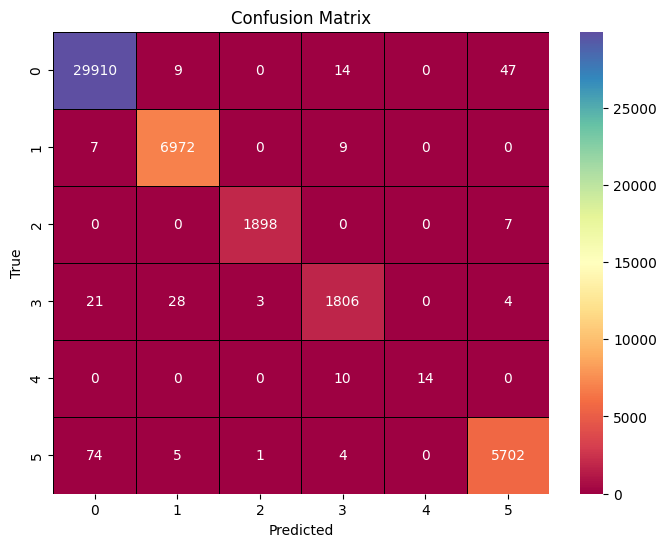

In [36]:
# Plot heatmap the confusion matrix

# Confusion MAtrix
cm = confusion_matrix(list(y_test.astype(int)), list(y_pred.astype(int)))

# Color
custom_cmap = sns.color_palette("Spectral", as_cmap=True)

# Create the heatmap
plt.figure(figsize=(8, 6))  # Adjust the figure size
sns.heatmap(cm, annot=True, cmap=custom_cmap, fmt='d', linewidths=0.5, linecolor='black', cbar=True)

# Add labels and a title
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')

# Show the plot
plt.show()


In [37]:
# Plot the clasiffication report

cr = classification_report(list(y_test.astype(int)), list(y_pred.astype(int)))
print(cr)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     29980
           1       0.99      1.00      1.00      6988
           2       1.00      1.00      1.00      1905
           3       0.98      0.97      0.97      1862
           4       1.00      0.58      0.74        24
           5       0.99      0.99      0.99      5786

    accuracy                           0.99     46545
   macro avg       0.99      0.92      0.95     46545
weighted avg       0.99      0.99      0.99     46545



In [38]:
acc=accuracy_score(list(y_test.astype(int)), list(y_pred.astype(int)))
acc

0.9947792458910731

In [39]:
# Calculate cross-validation scores using the entire dataset (X, y)
scores = cross_val_score(clf, X, y, cv=5, scoring='accuracy', n_jobs = -1)


# Calculate the mean of cross-validation scores for the current model
mean_cv_score = scores.mean()
mean_cv_score

0.9942120528520787

In [40]:
# classifier ..

# Select models

models_names = [
    "Nearest Neighbors",
    "SVC",
    "Decision Tree",
    "Random Forest",
    "Neural Net",
    "AdaBoost",
    "Naive Bayes",
    "QDA",
]


models = [
    KNeighborsClassifier(5),
    SVC(kernel="linear", C=0.025, random_state=42),
    DecisionTreeClassifier(max_depth=5, random_state=42),
    RandomForestClassifier(n_estimators=30, criterion='log_loss', random_state=42),
    MLPClassifier(alpha=1, max_iter=1000, random_state=42),
    AdaBoostClassifier(random_state=42),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
]

In [41]:
different_test_scores = []

# Model iteration
for model_name, model in zip(models_names, models):

    # Print model name
    print(f"Iterating Model: {model_name}")

    # Fit the model on the training data
    model.fit(X_train, y_train)

    # Predict on the test data
    y_pred = model.predict(X_test)

    # Calculate the R-squared score
    acc_score = accuracy_score(list(y_test.astype(int)), list(y_pred.astype(int)))

    # Append the test scores and MSE to the respective lists
    different_test_scores.append({'Model Name': model_name, 'Accuracy': acc_score})


# Create dataframes to store the test scores
comparing_classification_models_df = pd.DataFrame(different_test_scores)
comparing_classification_models_df = comparing_classification_models_df.sort_values(by='Accuracy', ascending=False)

# Display the results
round(comparing_classification_models_df, 3)

Iterating Model: Nearest Neighbors
Iterating Model: SVC
Iterating Model: Decision Tree
Iterating Model: Random Forest
Iterating Model: Neural Net
Iterating Model: AdaBoost
Iterating Model: Naive Bayes
Iterating Model: QDA


,Model Name,Accuracy
1,SVC,0.998
3,Random Forest,0.994
4,Neural Net,0.991
0,Nearest Neighbors,0.987
2,Decision Tree,0.980
5,AdaBoost,0.958
7,QDA,0.935
6,Naive Bayes,0.915


In [47]:
 # Cross Validation


# Lists to store the cross-validation scores for each model
different_test_scores_cv = []

# Save best model
best_model = None
best_accuracy = 0.0

# Perform 5-fold cross-validation for each classification model
for model_name, model in zip(models_names, models):

    # Print model name
    print(f"Iterating Model: {model_name}")

    # Calculate cross-validation scores using the entire dataset (X, y)
    scores = cross_val_score(model, X, y, cv=5, scoring='accuracy', n_jobs = -1)


    # Calculate the mean of cross-validation scores for the current model
    mean_cv_score = scores.mean()

    # Append the mean cross-validation score to the list
    different_test_scores_cv.append(mean_cv_score)


    # Check if this model has the best accuracy so far
    if mean_cv_score > best_accuracy:
        best_accuracy = mean_cv_score
        best_model = model

# Create a DataFrame to compare the models based on their cross-validation scores
comparing_classification_models_df_cv = pd.DataFrame(list(zip(models_names, different_test_scores_cv)),
                                                     columns=['Model Name', 'Cross Val Accuracy'])

# Sort the DataFrame by cross-validation score in descending order
comparing_classification_models_df_cv = comparing_classification_models_df_cv.sort_values(by="Cross Val Accuracy", ascending=False)

# Display the DataFrame with the results
round(comparing_classification_models_df_cv, 3)

Iterating Model: Nearest Neighbors
Iterating Model: SVC
Iterating Model: Decision Tree
Iterating Model: Random Forest
Iterating Model: Neural Net
Iterating Model: AdaBoost
Iterating Model: Naive Bayes
Iterating Model: QDA


,Model Name,Cross Val Accuracy
1,SVC,0.998
3,Random Forest,0.994
4,Neural Net,0.990
0,Nearest Neighbors,0.987
2,Decision Tree,0.980
5,AdaBoost,0.944
7,QDA,0.935
6,Naive Bayes,0.916


In [48]:
# Save the best model to a file using joblib
if best_model:
    joblib.dump(best_model, '../model/best_model.joblib')

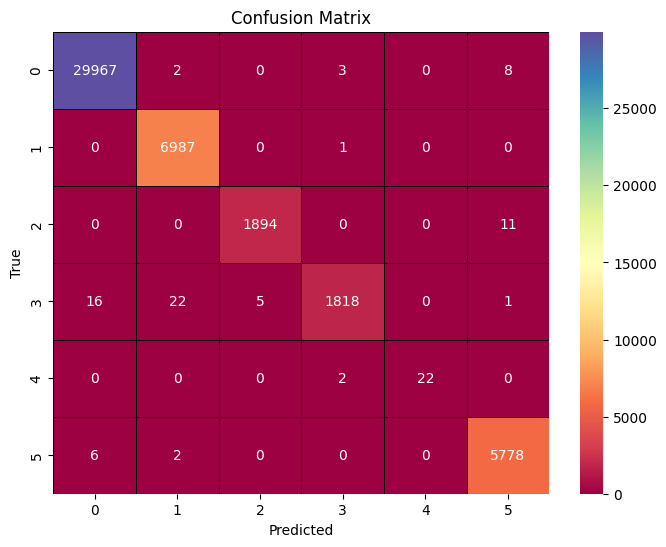

In [49]:
# Plot heatmap the confusion matrix

# Get predictions
y_pred_bm = best_model.predict(X_test)

# Confusion MAtrix
cm_bm = confusion_matrix(list(y_test.astype(int)), list(y_pred_bm.astype(int)))

# Color
custom_cmap = sns.color_palette("Spectral", as_cmap=True)

# Create the heatmap
plt.figure(figsize=(8, 6))  # Adjust the figure size
sns.heatmap(cm_bm, annot=True, cmap=custom_cmap, fmt='d', linewidths=0.5, linecolor='black', cbar=True)

# Add labels and a title
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')

# Show the plot
plt.show()

In [50]:

# Plot the clasiffication report

cr_bm = classification_report(list(y_test.astype(int)), list(y_pred_bm.astype(int)))
print(cr_bm)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     29980
           1       1.00      1.00      1.00      6988
           2       1.00      0.99      1.00      1905
           3       1.00      0.98      0.99      1862
           4       1.00      0.92      0.96        24
           5       1.00      1.00      1.00      5786

    accuracy                           1.00     46545
   macro avg       1.00      0.98      0.99     46545
weighted avg       1.00      1.00      1.00     46545

